# 👥 Group Information

1. **Mahmudur Rahman Mehraj** — ID: 2022-3-60-182  
2. **MD. Robiul Islam** — ID: 2023-1-60-093  
3. **Sunzid Ashraf Mahi** — ID: 2023-1-60-148


# Clear Current Output Directory

In [1]:
!rm -rf /kaggle/working/*

# Copy Dataset to working Directory

In [2]:
input_data_path = '/kaggle/input/object-detection-mendeley-yolo-v11/Object Detection Dataset  Navigation Assistance for the Visually Impaired People using YOLOv11/'
input_data_path2 = '/kaggle/input/object-detection-ewu/'
!cp -r "{input_data_path2}"* /kaggle/working/

data_path = '/kaggle/working'


In [3]:
# Installations
!pip install ttach
!pip install ultralytics --no-deps
!git clone https://github.com/rigvedrs/YOLO-V12-CAM.git
%cd /kaggle/working/YOLO-V12-CAM

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 19.0 MB/s eta 0:00:00
Cloning into 'YOLO-V12-CAM'...
remote: Enumerating objects: 168, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (56/56), done.
remote: Total 168 (delta 39), reused 21 (delta 11), pack-reused 99 (from 2)
Receiving objects: 100% (168/168), 52.67 MiB | 41.97 MiB/s, done.
Resolving deltas: 100% (70/70), done.
/kaggle/working/YOLO-V12-CAM


In [4]:
# Imports
import os
import cv2
import yaml
import random
import numpy as np
import pandas as pd
from pathlib import Path
from ultralytics import YOLO
import matplotlib.pyplot as plt
from yolo_cam.eigen_cam import EigenCAM
from yolo_cam.utils.image import show_cam_on_image, scale_cam_image


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# YAML data loading

In [5]:
yaml_path = data_path + '/data.yaml'
output_yaml_path = '/kaggle/working/data.yaml'

with open(yaml_path, 'r') as file:
    data = yaml.safe_load(file)

data['train'] = data_path + '/train/images'
data['val'] = data_path + '/valid/images'
data['test'] = data_path + '/test/images'

with open(output_yaml_path, 'w') as file:
    yaml.dump(data, file, default_flow_style=False)

print("Updated data.yaml:")
print(yaml.dump(data, default_flow_style=False))

Updated data.yaml:
names:
- Bin
- Building Pillar
- Bus
- CNG
- Car
- Cycle
- Electric Pole
- Food Van
- Food cart
- Footpath
- Leguna
- Motorcycle
- Obstacle
- Parking Cone
- Person
- Pickup
- Rickshaw
- Stairs
- Tree
- Truck
- Van
- Van gari
nc: 22
roboflow:
  license: CC BY 4.0
  project: custom-object-detect-1
  url: https://universe.roboflow.com/capstone-project-kxh1v/custom-object-detect-1/dataset/9
  version: 9
  workspace: capstone-project-kxh1v
test: /kaggle/working/test/images
train: /kaggle/working/train/images
val: /kaggle/working/valid/images



In [6]:
def inspect_label_format(split_name="train", num_files=3):
    """Inspect the format of label files"""
    base_path = Path(data_path)
    labels_path = base_path / split_name / "labels"

    print(f"🔍 Inspecting label format in '{split_name}' split:\n")

    label_files = list(labels_path.glob("*.txt"))[:num_files]

    for label_file in label_files:
        print(f"📄 File: {label_file.name}")
        with open(label_file, 'r') as f:
            lines = f.readlines()[:3]
            for i, line in enumerate(lines, 1):
                parts = line.strip().split()
                print(f"   Line {i}: {len(parts)} values -> {line.strip()}")
        print()

inspect_label_format()

🔍 Inspecting label format in 'train' split:

📄 File: frame_136s_jpg.rf.1f4f67b8ef96be9b030f3ec52f2946e6.txt
   Line 1: 209 values -> 16 0 0.7770072953125 0.0041425312499999995 0.777576690625 0.010829595312499999 0.7762987796874999 0.019956364062500002 0.7779441515625 0.024932326562500003 0.7754066546875 0.0349146453125 0.77768181875 0.05649651875 0.776658525 0.07325976875 0.7844889859374999 0.08618957968749999 0.7855518234375001 0.0885023375 0.78950900625 0.1169920890625 0.7930071078125 0.1200665296875 0.7907608781250001 0.1531183203125 0.8026902984375001 0.1642404796875 0.8108776093750001 0.17973694375 0.813829825 0.2271480484375 0.8075820484375 0.25766626718749996 0.80975498125 0.27889769062499997 0.819183553125 0.285457809375 0.81893954375 0.2889765640625 0.8130746562500001 0.292716134375 0.8130090734375001 0.3416148390625 0.8174388453124999 0.3642730765625 0.8228446515625001 0.3780253578125 0.8324043890624999 0.3686393234375 0.86326135625 0.366635875 0.9023712156249999 0.3880523468

# Visualization of YOLO dataset with polygon segmentation masks

TRAIN SPLIT

📸 Showing 3 sample images from 'train' split



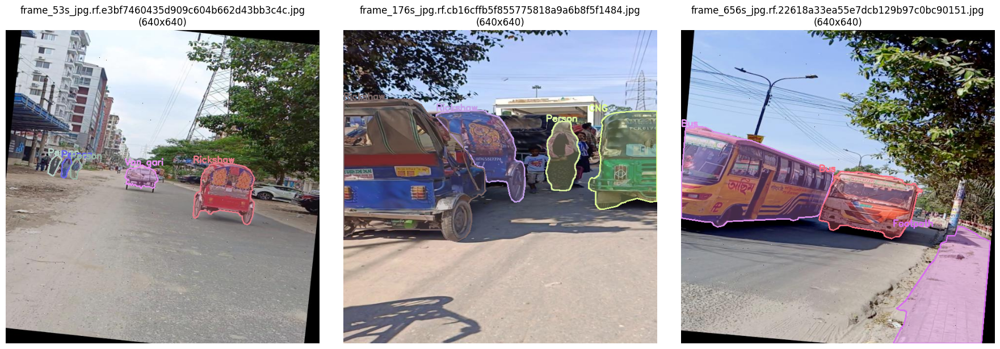


VALIDATION SPLIT

📸 Showing 3 sample images from 'valid' split



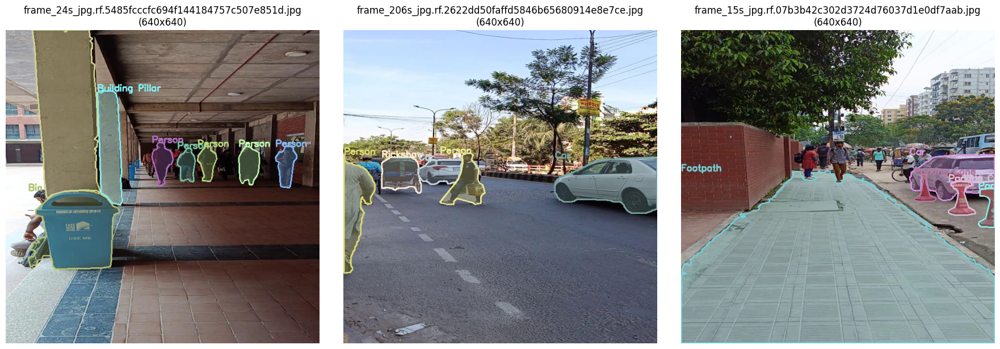


TEST SPLIT

📸 Showing 3 sample images from 'test' split



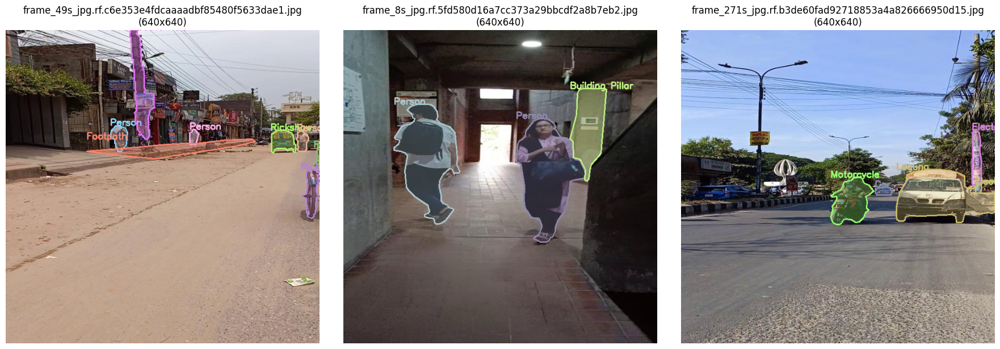

In [7]:
def visualize_yolo_polygon_split(split_name, num_images=3):

    base_path = Path(data_path)
    images_path = base_path / split_name / "images"
    labels_path = base_path / split_name / "labels"

    # Class names
    class_names = ['Bin', 'Building Pillar', 'Bus', 'CNG', 'Car', 'Cycle',
                   'Electric Pole', 'Food Van', 'Food cart', 'Footpath', 'Leguna',
                   'Motorcycle', 'Obstacle', 'Parking Cone', 'Person', 'Pickup',
                   'Rickshaw', 'Stairs', 'Tree', 'Truck', 'Van', 'Van gari']

    print(f"\n📸 Showing {num_images} sample images from '{split_name}' split\n")

    # Get image files
    image_files = list(images_path.glob("*.jpg")) + list(images_path.glob("*.png"))
    image_files = image_files[:num_images]

    # Create subplots
    fig, axes = plt.subplots(1, len(image_files), figsize=(6*len(image_files), 6))
    if len(image_files) == 1:
        axes = [axes]

    for idx, img_file in enumerate(image_files):
        # Read image
        img = cv2.imread(str(img_file))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w = img.shape[:2]

        # Read corresponding label
        label_file = labels_path / f"{img_file.stem}.txt"

        if label_file.exists():
            with open(label_file, 'r') as f:
                lines = f.readlines()

            for line in lines:
                parts = list(map(float, line.strip().split()))

                if len(parts) >= 3:  # At least class + 1 point (x,y)
                    cls = int(parts[0])

                    # Extract polygon coordinates (all values after class ID)
                    coords = parts[1:]

                    # Reshape into (N, 2) array of (x, y) points
                    num_points = len(coords) // 2
                    polygon_points = np.array(coords[:num_points * 2]).reshape(-1, 2)

                    # Convert normalized coordinates to pixel coordinates
                    polygon_points[:, 0] *= w
                    polygon_points[:, 1] *= h
                    polygon_points = polygon_points.astype(np.int32)

                    # Generate random color for this object
                    color = tuple(np.random.randint(100, 255, 3).tolist())

                    # Draw filled polygon (semi-transparent)
                    overlay = img.copy()
                    cv2.fillPoly(overlay, [polygon_points], color)
                    img = cv2.addWeighted(img, 0.7, overlay, 0.3, 0)

                    # Draw polygon outline
                    cv2.polylines(img, [polygon_points], True, color, 2)

                    # Add label at the top-left of the polygon
                    label = class_names[cls] if cls < len(class_names) else f"Class {cls}"
                    min_point = polygon_points.min(axis=0)
                    cv2.putText(img, label, tuple(min_point),
                               cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

        # Display
        axes[idx].imshow(img)
        axes[idx].axis('off')
        axes[idx].set_title(f"{img_file.name}\n({w}x{h})")

    plt.tight_layout()
    plt.show()

# Visualize each split
print("=" * 60)
print("TRAIN SPLIT")
print("=" * 60)
visualize_yolo_polygon_split("train", num_images=3)

print("\n" + "=" * 60)
print("VALIDATION SPLIT")
print("=" * 60)
visualize_yolo_polygon_split("valid", num_images=3)

print("\n" + "=" * 60)
print("TEST SPLIT")
print("=" * 60)
visualize_yolo_polygon_split("test", num_images=3)

# Load Dataset YAML

In [8]:
# ------------------------------------------------------------
# Load Dataset YAML
# ------------------------------------------------------------
yaml_path = Path(data_path + '/data.yaml')

with open(yaml_path, "r") as f:
    data_cfg = yaml.safe_load(f)

print("✅ Dataset loaded successfully:")
print(yaml.dump(data_cfg, sort_keys=False))


✅ Dataset loaded successfully:
names:
- Bin
- Building Pillar
- Bus
- CNG
- Car
- Cycle
- Electric Pole
- Food Van
- Food cart
- Footpath
- Leguna
- Motorcycle
- Obstacle
- Parking Cone
- Person
- Pickup
- Rickshaw
- Stairs
- Tree
- Truck
- Van
- Van gari
nc: 22
roboflow:
  license: CC BY 4.0
  project: custom-object-detect-1
  url: https://universe.roboflow.com/capstone-project-kxh1v/custom-object-detect-1/dataset/9
  version: 9
  workspace: capstone-project-kxh1v
test: /kaggle/working/test/images
train: /kaggle/working/train/images
val: /kaggle/working/valid/images



In [9]:
# ------------------------------------------------------------
# Hyper Parameters
# ------------------------------------------------------------
epoch = 50
batch_size = 64
image_size = 640
learning_rate = 0.01
learning_rate_fine = 0.001
patience = 15
optimizer = 'AdamW'
IOU = 0.7

# YOLO v12
## Model Training

In [10]:
# ------------------------------------------------------------
# Training
# ------------------------------------------------------------
model = YOLO("yolo12n.pt")

results = model.train(
    data=str(yaml_path),
    epochs=epoch,              # ← More epochs for 22 classes
    patience=patience,             # ← Longer patience for complex task
    imgsz=image_size,               # Or 800 if GPU memory allows
    batch=batch_size,                # ← Reduced batch for better gradient updates
    project="/kaggle/working",
    name="yolov12",
    device=0,
    workers=2,
    exist_ok=True,
    
    # Learning rate - important for multi-class
    lr0=learning_rate,
    lrf=learning_rate_fine,               # ← Lower final LR for fine-tuning

    
    # Stronger augmentation for 22 classes
    hsv_h=0.015,             # HSV-Hue augmentation
    hsv_s=0.7,               # HSV-Saturation
    hsv_v=0.4,               # HSV-Value
    degrees=20.0,            # Rotation
    translate=0.2,           # Translation
    scale=0.7,               # Scale
    shear=2.0,               # Shear
    perspective=0.0001,      # Perspective
    flipud=0.0,              # No vertical flip
    fliplr=0.5,              # Horizontal flip
    mosaic=1.0,              # Mosaic (great for multi-class)
    mixup=0.2,               # Mixup
    copy_paste=0.5,          # ← Higher for rare classes
    
    # Multi-class optimization
    optimizer=optimizer,
    weight_decay=0.0005,
    momentum=0.937,
    close_mosaic=10,         # Disable mosaic in last 10 epochs
    
    # Class-specific settings
    cls=0.5,                 # ← Class loss weight (important!)
    box=7.5,                 # Box loss weight
    dfl=1.5,                 # DFL loss weight
    
    # NMS settings for multiple classes
    iou=IOU,                 # IoU threshold
    conf=0.001,              # Low conf during training
    
    # Validation
    val=True,
    save=True,
    save_period=25,
    plots=True,
    
    # Performance
    amp=True,
    rect=False,              # Rectangular training (can help)
    
    # Verbose
    verbose=True,
)

print("\n✅ Training complete. Best model saved in:")
print(model.ckpt_path)

Ultralytics 8.3.240 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=64, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=0.001, copy_paste=0.5, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/data.yaml, degrees=20.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.001, mask_ratio=4, max_det=300, mixup=0.2, mode=train, model=yolo12n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov12, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=15, perspective=0.0001, plots=True, pose=

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        551       2464      0.738      0.738      0.765      0.628
                   Bin         25         25      0.479       0.04     0.0914     0.0692
       Building Pillar         73        193      0.846      0.782      0.863      0.652
                   Bus         53         61      0.894      0.869      0.936      0.848
                   CNG         44         56      0.854      0.911      0.928      0.852
                   Car        157        332      0.881      0.733      0.861      0.739
                 Cycle         40         41      0.749      0.756      0.817      0.648
         Electric Pole        101        107      0.789      0.794      0.827      0.624
              Food Van         14         15      0.702      0.667      0.811      0.642
             Food cart          4          4      0.772          1      0.796       0.63
              Footpath        184        186      0.921      0.941      0.968      0.813
                Legun

## Evaluation on Validation and Test Sets

In [11]:
# ------------------------------------------------------------
# Evaluation on Validation and Test Sets
# ------------------------------------------------------------
print("\n📊 Evaluating on validation set...")
val_metrics = model.val(data=str(yaml_path), split="val")
print("\nValidation Results:")
# print(val_metrics)

print("\n📊 Evaluating on test set...")
test_metrics = model.val(data=str(yaml_path), split="test")
print("\nTest Results:")
# print(test_metrics)


📊 Evaluating on validation set...
Ultralytics 8.3.240 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,561,018 parameters, 0 gradients
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1584.2±717.1 MB/s, size: 66.9 KB)
val: Scanning /kaggle/working/valid/labels.cache... 551 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 551/551 1.2Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 35/35 5.1it/s 6.9s


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        551       2464      0.737       0.74      0.764      0.627
                   Bin         25         25      0.475       0.04     0.0914     0.0655
       Building Pillar         73        193      0.839      0.782      0.863      0.652
                   Bus         53         61      0.893      0.869      0.936      0.853
                   CNG         44         56      0.852      0.911      0.928      0.852
                   Car        157        332      0.881      0.735      0.861       0.74
                 Cycle         40         41      0.747      0.756      0.817      0.645
         Electric Pole        101        107      0.784      0.794      0.827      0.623
              Food Van         14         15        0.7      0.667      0.808      0.636
             Food cart          4          4      0.762          1      0.796       0.63
              Footpath        184        186      0.926      0.941      0.969      0.812
                Legun

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        540       2899      0.659      0.705      0.746        0.6
                   Bin         26         38          0          0     0.0162    0.00993
       Building Pillar         72        182      0.713      0.786      0.828      0.623
                   Bus         31         39       0.75      0.921      0.911      0.795
                   CNG        114        147       0.83      0.925      0.954      0.837
                   Car        217        495      0.841      0.848       0.91       0.78
                 Cycle         18         18      0.388      0.611      0.523      0.422
         Electric Pole         79         93      0.662      0.716      0.652      0.451
              Food Van         10         12      0.827      0.797       0.92      0.788
             Food cart         22         31      0.767      0.871      0.881      0.682
              Footpath        120        132      0.734      0.856      0.883      0.707
                Legun

## Training Predictions Visualization


🧠 Running inference for visualization...
Looking for images in: /kaggle/working/valid/images
✅ Found 551 images

📸 Processing: frame_180s_jpg.rf.915b3278a8d09aabc6b4dd21009f1f82.jpg

image 1/1 /kaggle/working/valid/images/frame_180s_jpg.rf.915b3278a8d09aabc6b4dd21009f1f82.jpg: 640x640 1 Cycle, 1 Electric Pole, 2 Rickshaws, 14.9ms
Speed: 1.7ms preprocess, 14.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


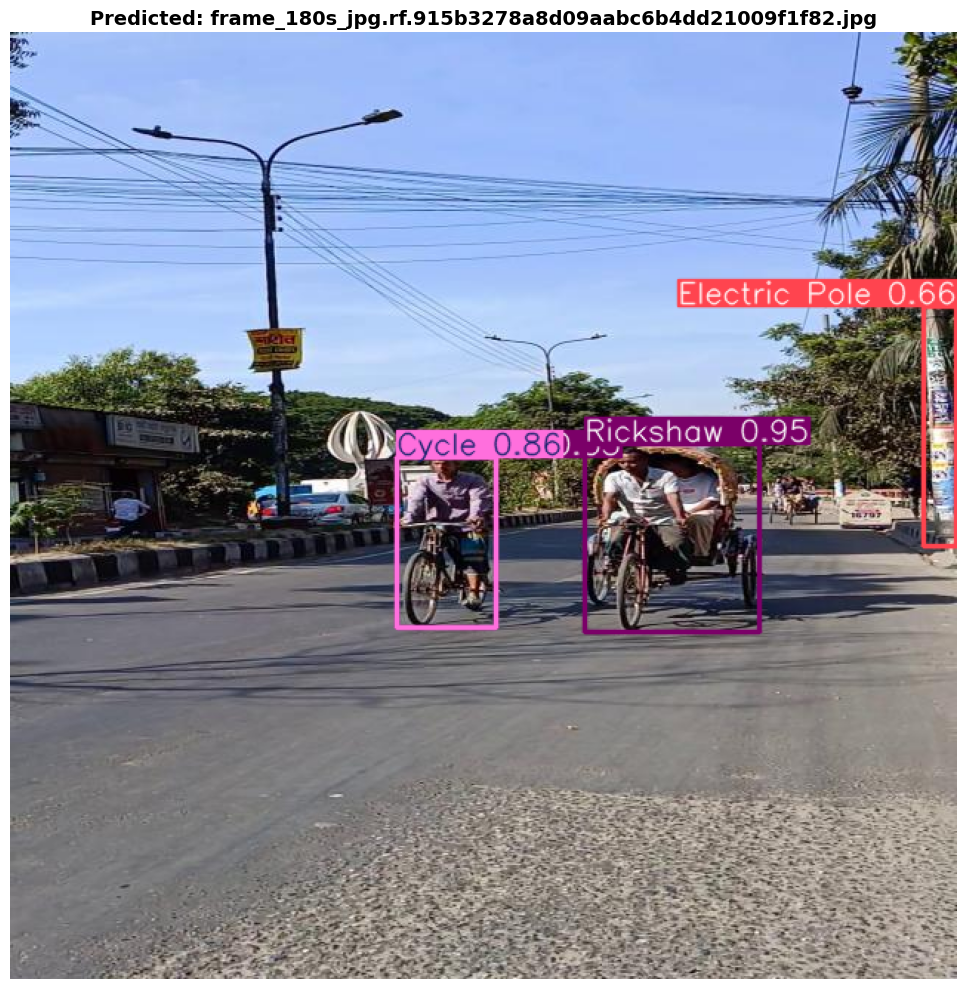

   Detected 4 objects
   - Rickshaw: 94.72%
   - Cycle: 86.11%
   - Electric Pole: 65.75%
   - Rickshaw: 33.10%

📸 Processing: frame_263s_jpg.rf.9773cd298b5cb14fd3bfa3b6e05d7a7e.jpg

image 1/1 /kaggle/working/valid/images/frame_263s_jpg.rf.9773cd298b5cb14fd3bfa3b6e05d7a7e.jpg: 640x640 1 Footpath, 2 Persons, 1 Van gari, 12.4ms
Speed: 1.4ms preprocess, 12.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


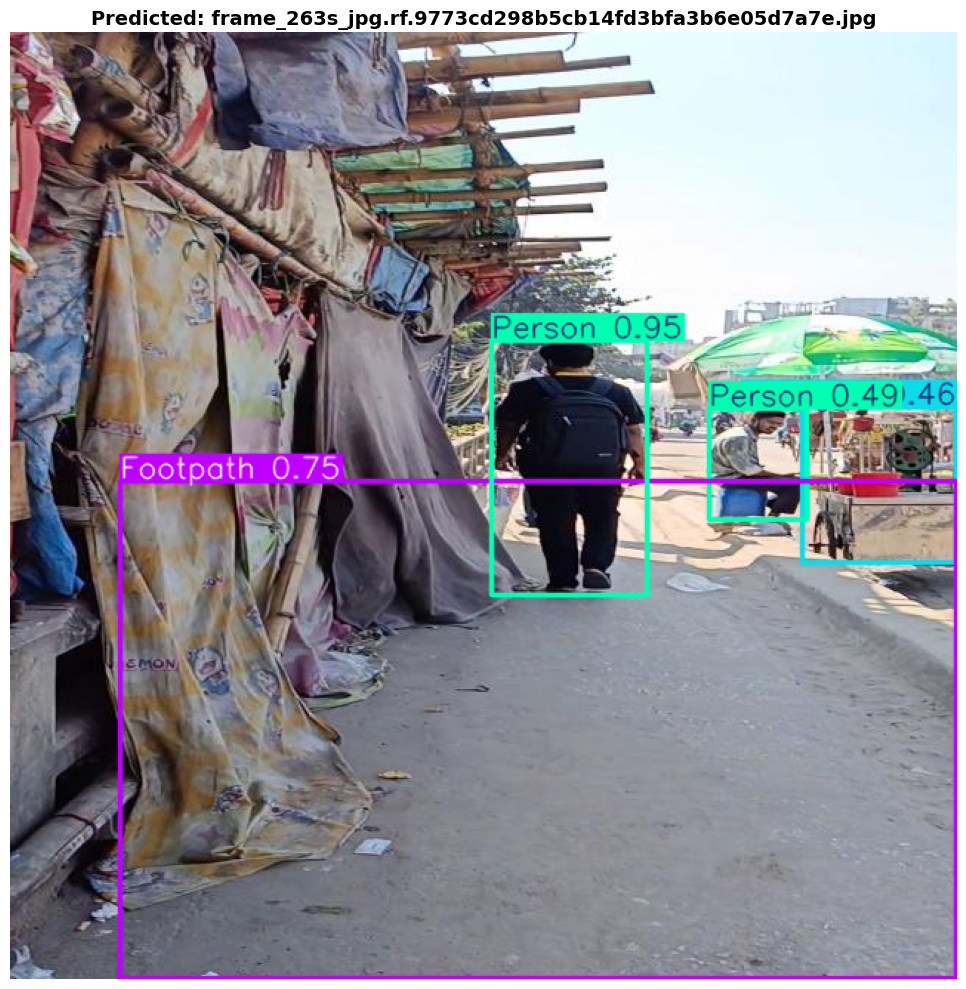

   Detected 4 objects
   - Person: 95.05%
   - Footpath: 75.30%
   - Person: 48.80%
   - Van gari: 46.18%

📸 Processing: frame_5s_jpg.rf.f6d4144b6cafd7f9151b1a62a6f90125.jpg

image 1/1 /kaggle/working/valid/images/frame_5s_jpg.rf.f6d4144b6cafd7f9151b1a62a6f90125.jpg: 640x640 1 Electric Pole, 1 Footpath, 1 Person, 1 Van gari, 12.6ms
Speed: 1.4ms preprocess, 12.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


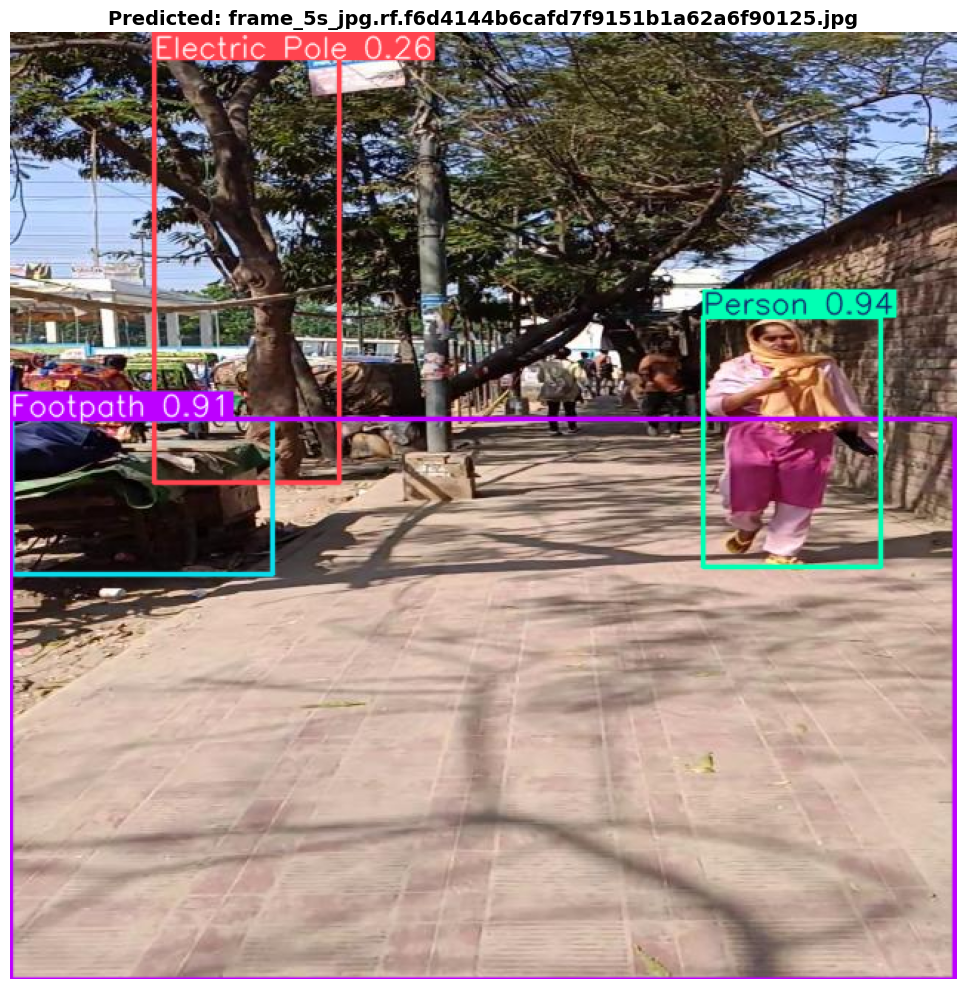

   Detected 4 objects
   - Person: 93.53%
   - Footpath: 90.77%
   - Van gari: 76.44%
   - Electric Pole: 26.40%

📸 Processing: frame_183s_jpg.rf.0dd6547b9bb698387739e6be8dae20f0.jpg

image 1/1 /kaggle/working/valid/images/frame_183s_jpg.rf.0dd6547b9bb698387739e6be8dae20f0.jpg: 640x640 2 CNGs, 2 Cars, 1 Rickshaw, 12.4ms
Speed: 1.4ms preprocess, 12.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


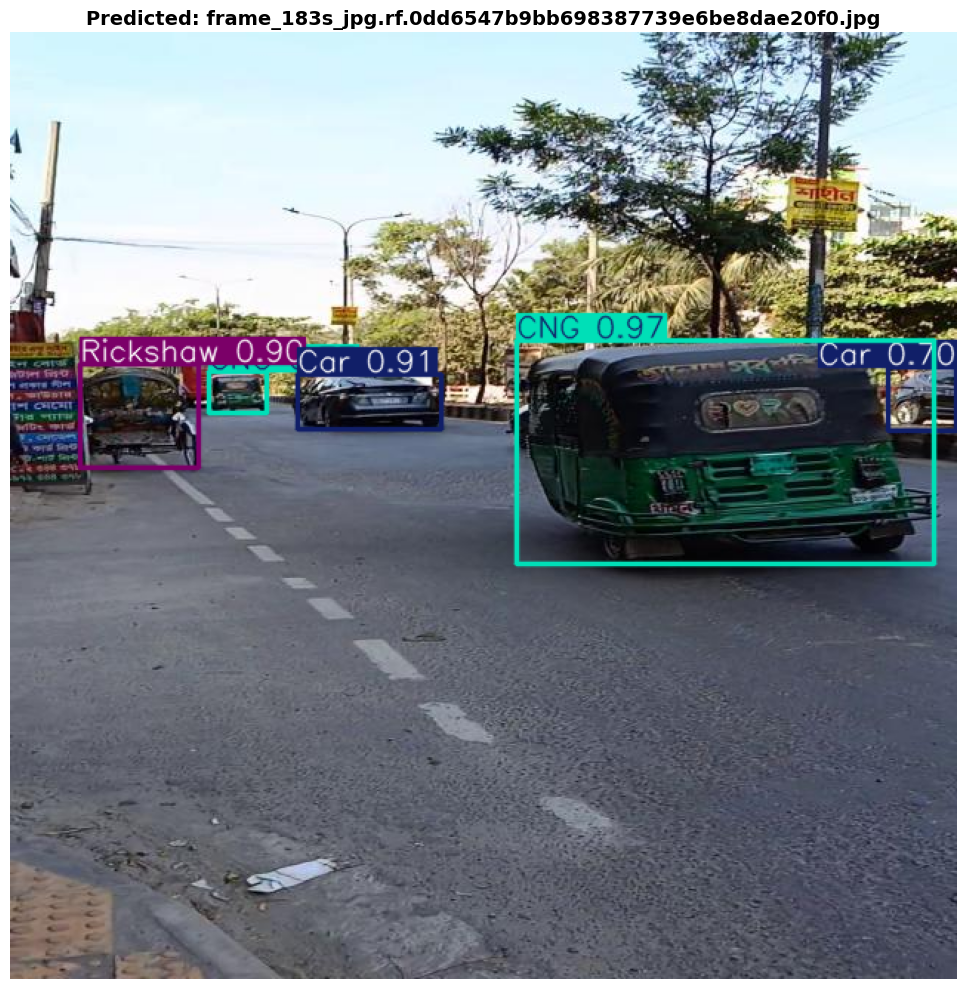

   Detected 5 objects
   - CNG: 96.68%
   - Car: 91.31%
   - Rickshaw: 89.97%
   - CNG: 77.18%
   - Car: 69.51%

📸 Processing: frame_62s_jpg.rf.e7bd191f305d0bd2686eb0df1001d290.jpg

image 1/1 /kaggle/working/valid/images/frame_62s_jpg.rf.e7bd191f305d0bd2686eb0df1001d290.jpg: 640x640 4 Cars, 1 Motorcycle, 3 Persons, 1 Rickshaw, 13.8ms
Speed: 1.6ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


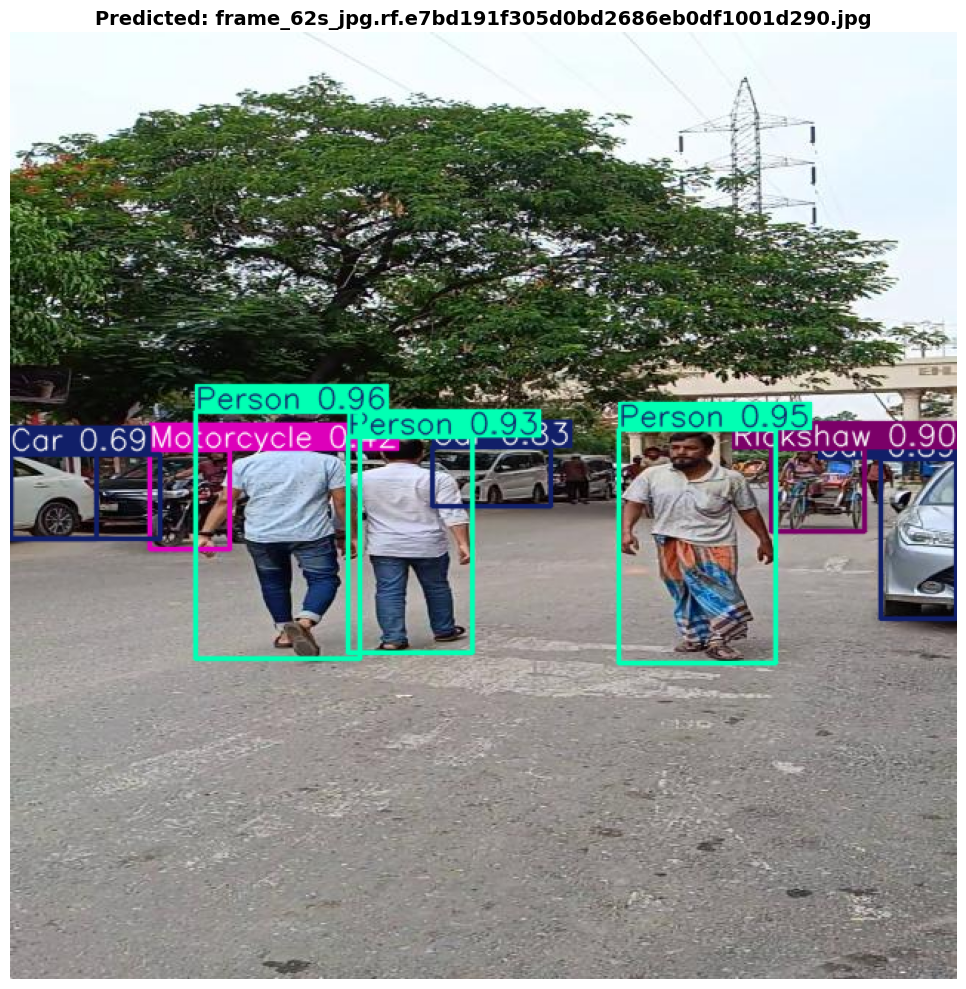

   Detected 9 objects
   - Person: 95.59%
   - Person: 94.86%
   - Person: 93.20%
   - Rickshaw: 90.13%
   - Car: 89.00%
   - Car: 83.42%
   - Car: 68.70%
   - Car: 55.80%
   - Motorcycle: 42.39%

📸 Processing: frame_12s_jpg.rf.e87b4e750163af9154d4502b4d446516.jpg

image 1/1 /kaggle/working/valid/images/frame_12s_jpg.rf.e87b4e750163af9154d4502b4d446516.jpg: 640x640 1 CNG, 1 Electric Pole, 1 Footpath, 6 Persons, 1 Rickshaw, 20.9ms
Speed: 1.6ms preprocess, 20.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


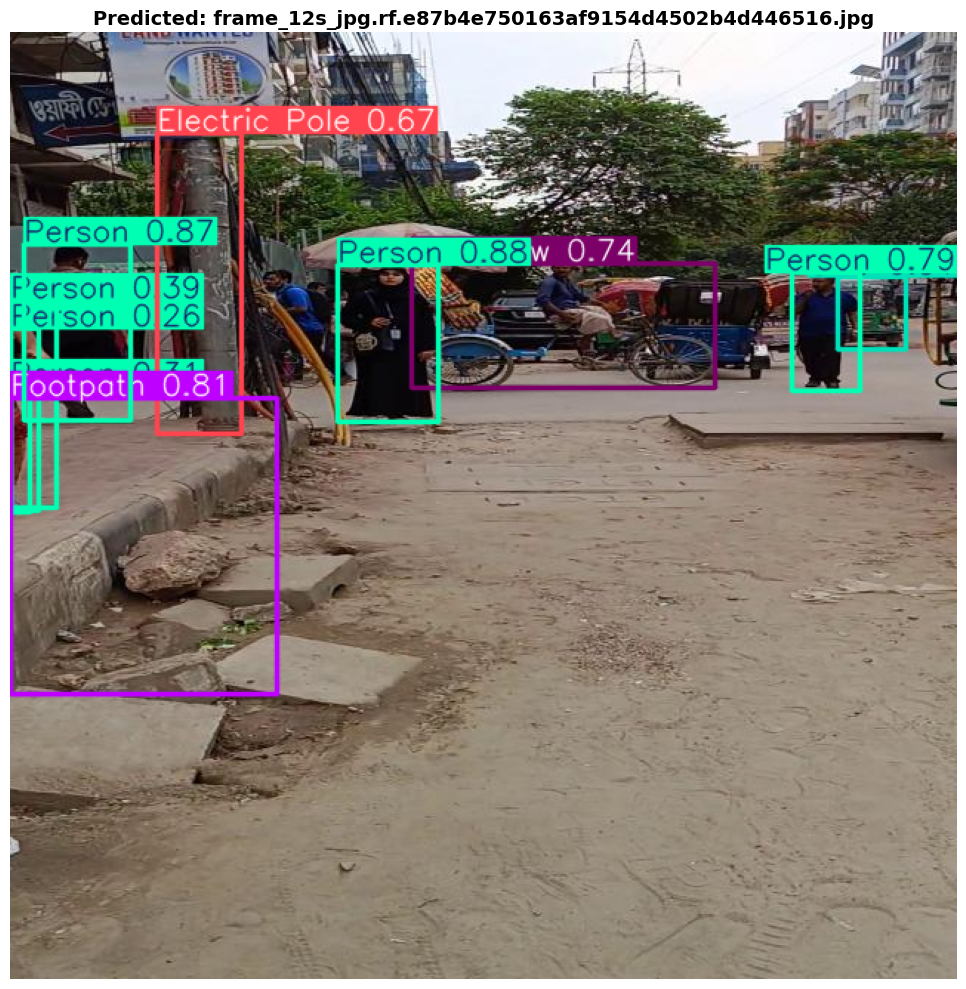

   Detected 10 objects
   - Person: 88.28%
   - Person: 87.27%
   - Footpath: 80.51%
   - Person: 78.96%
   - Rickshaw: 74.02%
   - Electric Pole: 67.08%
   - Person: 38.87%
   - CNG: 31.07%
   - Person: 30.72%
   - Person: 25.58%

📸 Processing: frame_118s_jpg.rf.264e0ba142e30e0b7f6f506898a948b2.jpg

image 1/1 /kaggle/working/valid/images/frame_118s_jpg.rf.264e0ba142e30e0b7f6f506898a948b2.jpg: 640x640 1 Bus, 2 Cars, 1 Cycle, 1 Motorcycle, 1 Pickup, 16.0ms
Speed: 1.6ms preprocess, 16.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


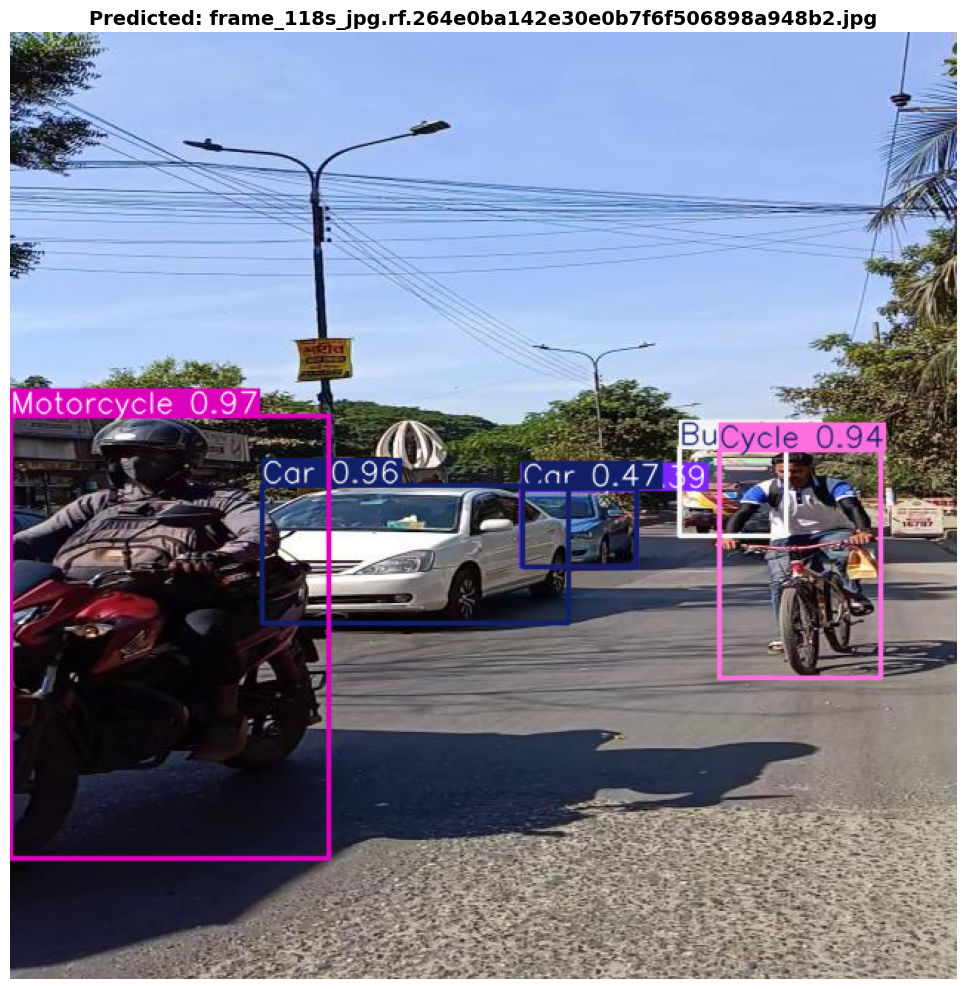

   Detected 6 objects
   - Motorcycle: 97.06%
   - Car: 95.87%
   - Cycle: 94.42%
   - Car: 47.22%
   - Bus: 39.88%
   - Pickup: 39.21%

📸 Processing: frame_3s_jpg.rf.94372e6f8ad7757a5e617ba72e4c7f5b.jpg

image 1/1 /kaggle/working/valid/images/frame_3s_jpg.rf.94372e6f8ad7757a5e617ba72e4c7f5b.jpg: 640x640 1 Bin, 1 Car, 1 Electric Pole, 1 Footpath, 3 Persons, 1 Rickshaw, 1 Stairs, 15.0ms
Speed: 1.6ms preprocess, 15.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


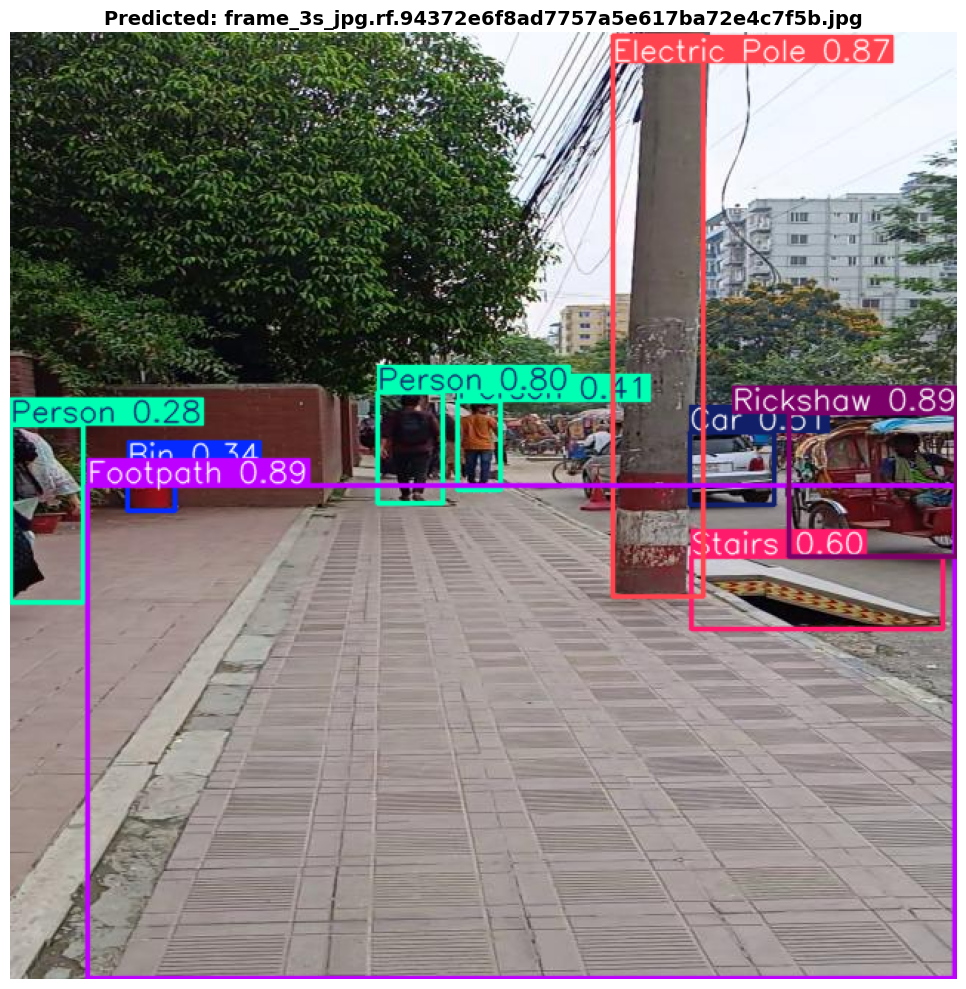

   Detected 9 objects
   - Rickshaw: 88.89%
   - Footpath: 88.70%
   - Electric Pole: 87.10%
   - Person: 79.79%
   - Stairs: 60.33%
   - Car: 50.63%
   - Person: 41.49%
   - Bin: 34.22%
   - Person: 28.18%

📸 Processing: frame_461s_jpg.rf.d423580c48e6b8ba7cc67a6017c3136e.jpg

image 1/1 /kaggle/working/valid/images/frame_461s_jpg.rf.d423580c48e6b8ba7cc67a6017c3136e.jpg: 640x640 1 Electric Pole, 1 Footpath, 15.1ms
Speed: 1.7ms preprocess, 15.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


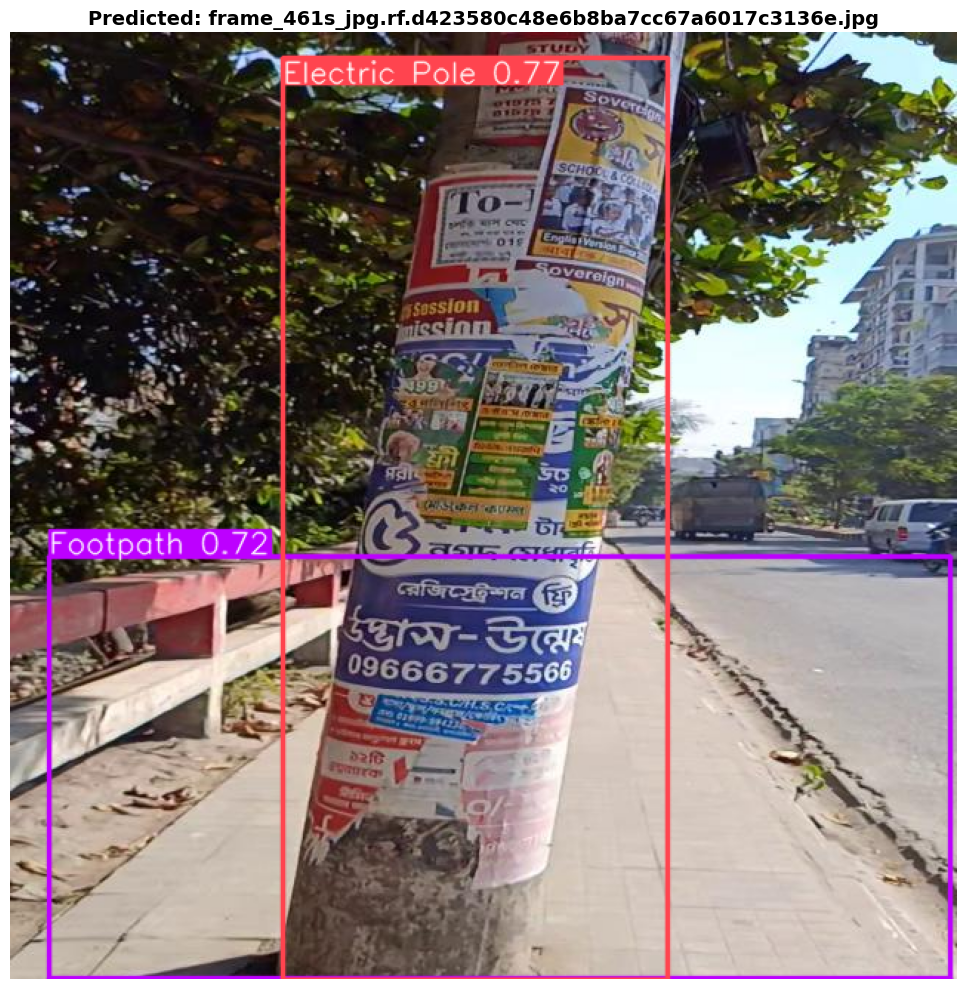

   Detected 2 objects
   - Electric Pole: 77.40%
   - Footpath: 71.58%

📸 Processing: frame_557s_jpg.rf.ecfcee890d4be8568f54b1fe270bb97d.jpg

image 1/1 /kaggle/working/valid/images/frame_557s_jpg.rf.ecfcee890d4be8568f54b1fe270bb97d.jpg: 640x640 1 CNG, 1 Car, 13.0ms
Speed: 1.4ms preprocess, 13.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


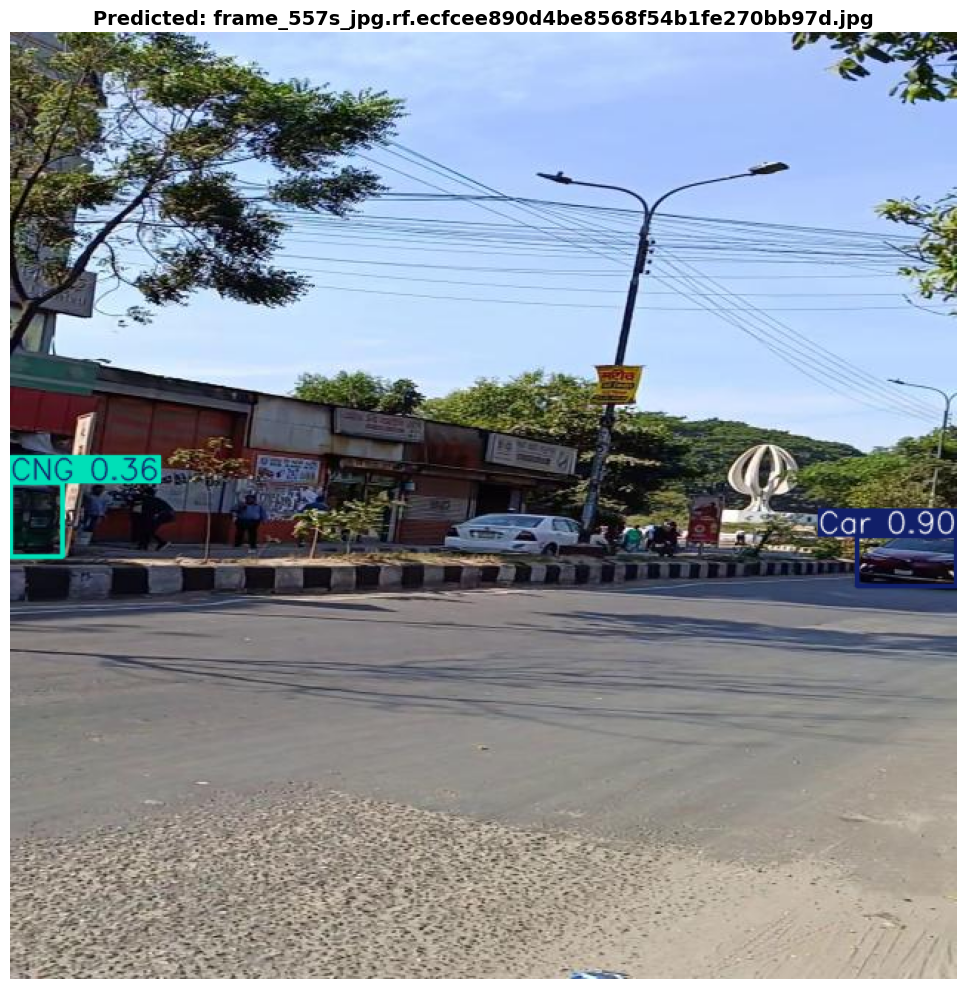

   Detected 2 objects
   - Car: 90.20%
   - CNG: 35.58%


In [12]:
# ------------------------------------------------------------
# Training Predictions Visualization
# ------------------------------------------------------------
print("\n🧠 Running inference for visualization...")

val_path = Path((data_cfg["val"])[0:])
print(f"Looking for images in: {val_path}")

sample_imgs = list(val_path.glob("*.jpg")) + list(val_path.glob("*.png"))

if not sample_imgs:
    print(f"❌ No images found in {val_path}")
    print("Available files:")
    print(list(val_path.glob("*"))[:10])
else:
    print(f"✅ Found {len(sample_imgs)} images")

    num_samples = min(10, len(sample_imgs))
    sample_imgs = random.sample(sample_imgs, num_samples)

    for img_path in sample_imgs:
        print(f"\n📸 Processing: {img_path.name}")

        results = model(str(img_path))
        annotated = results[0].plot() 

        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(f"Predicted: {img_path.name}", fontsize=14, fontweight='bold')
        plt.tight_layout()
        plt.show()

        boxes = results[0].boxes
        if len(boxes) > 0:
            print(f"   Detected {len(boxes)} objects")
            for box in boxes:
                cls_id = int(box.cls[0])
                conf = float(box.conf[0])
                cls_name = model.names[cls_id]
                print(f"   - {cls_name}: {conf:.2%}")
        else:
            print("   No objects detected")

## Loss and mAP Curves 


✅ Loaded training metrics from: /kaggle/working/yolov12/results.csv
Available columns: ['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss', 'lr/pg0', 'lr/pg1', 'lr/pg2']
✅ Saved loss plot to: /kaggle/working/yolov12/training_plots/training_loss_curves.png


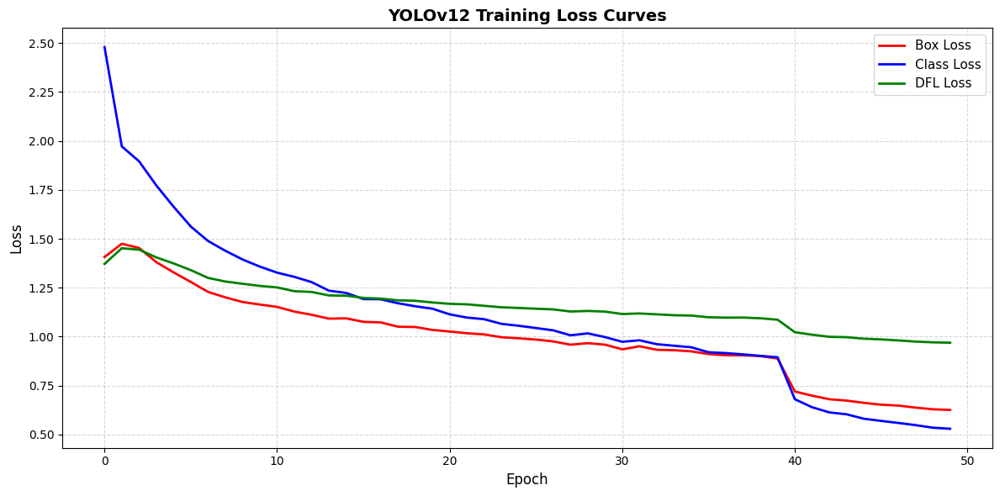

✅ Saved mAP plot to: /kaggle/working/yolov12/training_plots/validation_mAP_curves.png


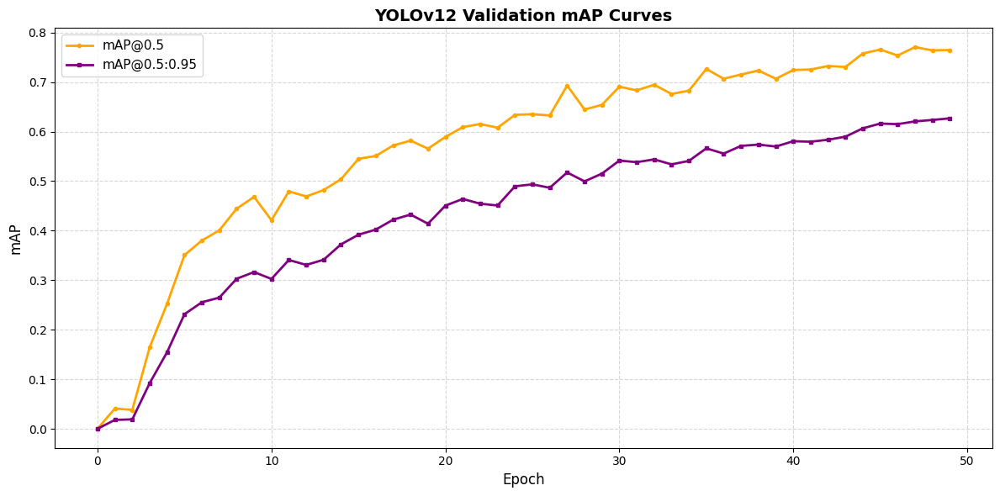

✅ Saved metrics plot to: /kaggle/working/yolov12/training_plots/validation_metrics.png


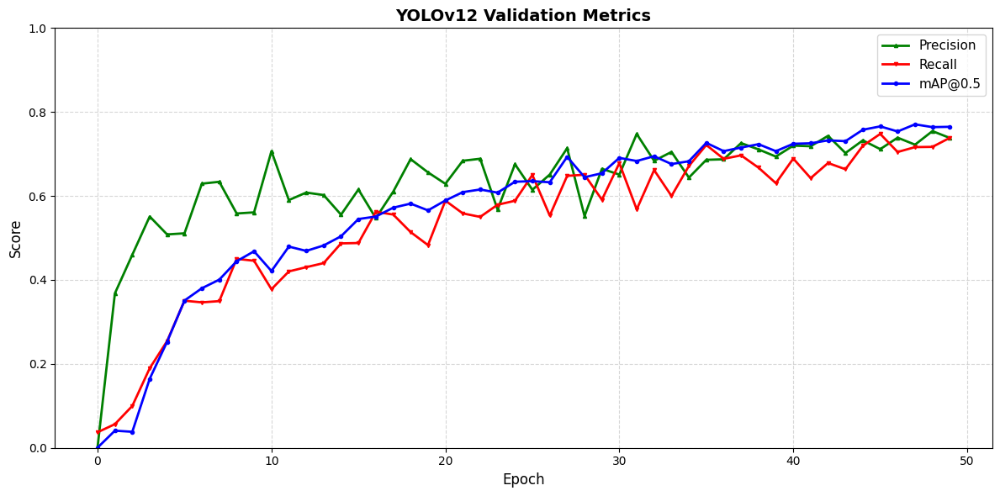

✅ Saved combined plot to: /kaggle/working/yolov12/training_plots/training_summary.png


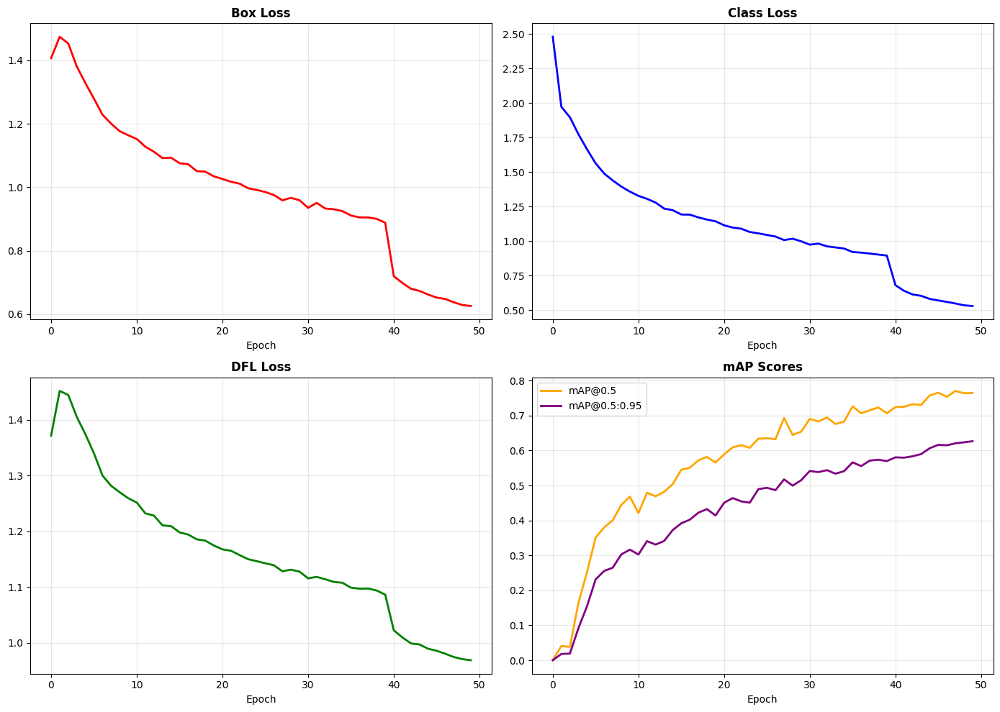

✅ Saved training summary to: /kaggle/working/yolov12/training_plots/training_summary.txt

📁 All plots and summary saved to: /kaggle/working/yolov12/training_plots

Files created:
  1. training_loss_curves.png
  2. validation_mAP_curves.png
  3. validation_metrics.png
  4. training_summary.png
  5. training_summary.txt


In [13]:
# ------------------------------------------------------------
# Loss and mAP Curves 
# ------------------------------------------------------------
results_csv = '/kaggle/working/yolov12/results.csv'

if not os.path.exists(results_csv):
    print(f"❌ results.csv not found at {results_csv}")
else:
    # Load metrics
    df = pd.read_csv(results_csv)
    print(f"\n✅ Loaded training metrics from: {results_csv}")
    print(f"Available columns: {df.columns.tolist()}")
    
    # Clean column names (remove leading/trailing spaces)
    df.columns = df.columns.str.strip()
    
    # Create output directory
    output_dir = '/kaggle/working/yolov12/training_plots'
    os.makedirs(output_dir, exist_ok=True)
    
    # ------------------------------------------------------------
    # Plot 1: Loss curves
    # ------------------------------------------------------------
    plt.figure(figsize=(12, 6))
    plt.plot(df.index, df["train/box_loss"], label="Box Loss", color="red", linewidth=2)
    plt.plot(df.index, df["train/cls_loss"], label="Class Loss", color="blue", linewidth=2)
    plt.plot(df.index, df["train/dfl_loss"], label="DFL Loss", color="green", linewidth=2)
    plt.xlabel("Epoch", fontsize=12)
    plt.ylabel("Loss", fontsize=12)
    plt.title("YOLOv12 Training Loss Curves", fontsize=14, fontweight='bold')
    plt.legend(fontsize=11)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.tight_layout()
    
    # Save to working directory (shows up in Kaggle output)
    loss_plot_path = os.path.join(output_dir, 'training_loss_curves.png')
    plt.savefig(loss_plot_path, dpi=150, bbox_inches='tight')
    print(f"✅ Saved loss plot to: {loss_plot_path}")
    plt.show()
    plt.close()
    
    # ------------------------------------------------------------
    # Plot 2: mAP curves
    # ------------------------------------------------------------
    plt.figure(figsize=(12, 6))
    plt.plot(df.index, df["metrics/mAP50(B)"], label="mAP@0.5", 
             color="orange", linewidth=2, marker='o', markersize=3)
    plt.plot(df.index, df["metrics/mAP50-95(B)"], label="mAP@0.5:0.95", 
             color="purple", linewidth=2, marker='s', markersize=3)
    plt.xlabel("Epoch", fontsize=12)
    plt.ylabel("mAP", fontsize=12)
    plt.title("YOLOv12 Validation mAP Curves", fontsize=14, fontweight='bold')
    plt.legend(fontsize=11)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.tight_layout()
    
    # Save to working directory
    map_plot_path = os.path.join(output_dir, 'validation_mAP_curves.png')
    plt.savefig(map_plot_path, dpi=150, bbox_inches='tight')
    print(f"✅ Saved mAP plot to: {map_plot_path}")
    plt.show()
    plt.close()
    
    # ------------------------------------------------------------
    # Plot 3: Combined metrics (Precision, Recall, mAP)
    # ------------------------------------------------------------
    plt.figure(figsize=(12, 6))
    plt.plot(df.index, df["metrics/precision(B)"], label="Precision", 
             color="green", linewidth=2, marker='^', markersize=3)
    plt.plot(df.index, df["metrics/recall(B)"], label="Recall", 
             color="red", linewidth=2, marker='v', markersize=3)
    plt.plot(df.index, df["metrics/mAP50(B)"], label="mAP@0.5", 
             color="blue", linewidth=2, marker='o', markersize=3)
    plt.xlabel("Epoch", fontsize=12)
    plt.ylabel("Score", fontsize=12)
    plt.title("YOLOv12 Validation Metrics", fontsize=14, fontweight='bold')
    plt.legend(fontsize=11)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.ylim([0, 1])  # Set y-axis from 0 to 1
    plt.tight_layout()
    
    # Save to working directory
    metrics_plot_path = os.path.join(output_dir, 'validation_metrics.png')
    plt.savefig(metrics_plot_path, dpi=150, bbox_inches='tight')
    print(f"✅ Saved metrics plot to: {metrics_plot_path}")
    plt.show()
    plt.close()
    
    # ------------------------------------------------------------
    # Plot 4: All losses in one subplot
    # ------------------------------------------------------------
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))
    
    # Training losses
    axes[0, 0].plot(df.index, df["train/box_loss"], color="red", linewidth=2)
    axes[0, 0].set_title("Box Loss", fontweight='bold')
    axes[0, 0].set_xlabel("Epoch")
    axes[0, 0].grid(True, alpha=0.3)
    
    axes[0, 1].plot(df.index, df["train/cls_loss"], color="blue", linewidth=2)
    axes[0, 1].set_title("Class Loss", fontweight='bold')
    axes[0, 1].set_xlabel("Epoch")
    axes[0, 1].grid(True, alpha=0.3)
    
    axes[1, 0].plot(df.index, df["train/dfl_loss"], color="green", linewidth=2)
    axes[1, 0].set_title("DFL Loss", fontweight='bold')
    axes[1, 0].set_xlabel("Epoch")
    axes[1, 0].grid(True, alpha=0.3)
    
    # mAP comparison
    axes[1, 1].plot(df.index, df["metrics/mAP50(B)"], label="mAP@0.5", 
                    color="orange", linewidth=2)
    axes[1, 1].plot(df.index, df["metrics/mAP50-95(B)"], label="mAP@0.5:0.95", 
                    color="purple", linewidth=2)
    axes[1, 1].set_title("mAP Scores", fontweight='bold')
    axes[1, 1].set_xlabel("Epoch")
    axes[1, 1].legend()
    axes[1, 1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    
    # Save combined plot
    combined_plot_path = os.path.join(output_dir, 'training_summary.png')
    plt.savefig(combined_plot_path, dpi=150, bbox_inches='tight')
    print(f"✅ Saved combined plot to: {combined_plot_path}")
    plt.show()
    plt.close()
    
    # ------------------------------------------------------------
    # Save summary statistics
    # ------------------------------------------------------------
    summary_path = os.path.join(output_dir, 'training_summary.txt')
    with open(summary_path, 'w') as f:
        f.write("YOLOv12 Training Summary\n")
        f.write("=" * 60 + "\n\n")
        f.write(f"Total Epochs: {len(df)}\n\n")
        
        f.write("Final Metrics:\n")
        f.write("-" * 60 + "\n")
        f.write(f"Train Box Loss: {df['train/box_loss'].iloc[-1]:.4f}\n")
        f.write(f"Train Class Loss: {df['train/cls_loss'].iloc[-1]:.4f}\n")
        f.write(f"Train DFL Loss: {df['train/dfl_loss'].iloc[-1]:.4f}\n\n")
        
        f.write(f"Validation Precision: {df['metrics/precision(B)'].iloc[-1]:.4f}\n")
        f.write(f"Validation Recall: {df['metrics/recall(B)'].iloc[-1]:.4f}\n")
        f.write(f"Validation mAP@0.5: {df['metrics/mAP50(B)'].iloc[-1]:.4f}\n")
        f.write(f"Validation mAP@0.5:0.95: {df['metrics/mAP50-95(B)'].iloc[-1]:.4f}\n\n")
        
        f.write("Best Metrics:\n")
        f.write("-" * 60 + "\n")
        f.write(f"Best mAP@0.5: {df['metrics/mAP50(B)'].max():.4f} at epoch {df['metrics/mAP50(B)'].idxmax()}\n")
        f.write(f"Best mAP@0.5:0.95: {df['metrics/mAP50-95(B)'].max():.4f} at epoch {df['metrics/mAP50-95(B)'].idxmax()}\n")
        f.write(f"Best Precision: {df['metrics/precision(B)'].max():.4f} at epoch {df['metrics/precision(B)'].idxmax()}\n")
        f.write(f"Best Recall: {df['metrics/recall(B)'].max():.4f} at epoch {df['metrics/recall(B)'].idxmax()}\n")
    
    print(f"✅ Saved training summary to: {summary_path}")
    
    print(f"\n{'='*60}")
    print(f"📁 All plots and summary saved to: {output_dir}")
    print(f"{'='*60}")
    print(f"\nFiles created:")
    print(f"  1. training_loss_curves.png")
    print(f"  2. validation_mAP_curves.png")
    print(f"  3. validation_metrics.png")
    print(f"  4. training_summary.png")
    print(f"  5. training_summary.txt")


## XAI


In [14]:
%cd /kaggle/working/YOLO-V12-CAM

/kaggle/working/YOLO-V12-CAM


In [15]:
model = YOLO(data_path + '/yolov12/weights/best.pt')
model = model.cpu()

In [16]:
img = cv2.imread('/kaggle/input/object-detection-ewu/train/images/frame_0s_jpg.rf.05d81773433c10ba035e8c1c7a6e8407.jpg')
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = np.float32(img) / 255

In [17]:
target_layers =[model.model.model[-2]]


0: 640x640 1 Car, 1 Electric Pole, 1 Footpath, 1 Parking Cone, 2 Persons, 2 Rickshaws, 154.3ms
Speed: 1.9ms preprocess, 154.3ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


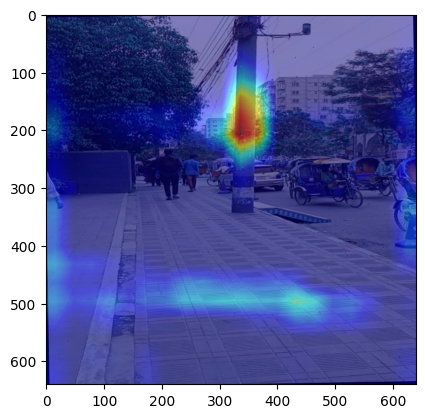

In [18]:
cam = EigenCAM(model, target_layers,task='od')
grayscale_cam = cam(rgb_img)[0, :, :]
cam_image = show_cam_on_image(img, grayscale_cam, use_rgb=True)
plt.imshow(cam_image)
plt.show()

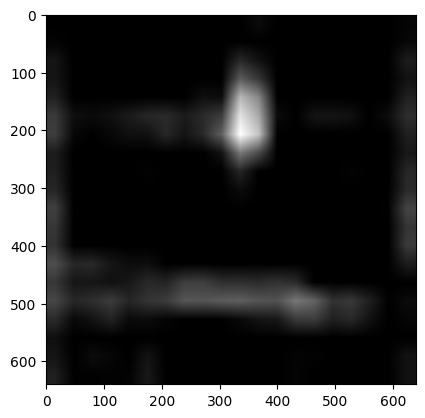

In [19]:
g_scale = np.stack([grayscale_cam] * 3, axis=2)
plt.imshow(g_scale)